In [ ]:
import re
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from datetime import timedelta, datetime, time
from matplotlib import dates as mdates
from plotly import express as px

In [ ]:
df = pd.read_csv("ytdf.csv")
df.head()

,title,channelName,published,description,tags,category,viewCount,likeCount,dislikeCount,commentCount,duration,postingDate,made_for_kids
0,Garten of BanBan 3,Markiplier,2023-05-22T16:27:31Z,Chapter 3 of Garten of BanBan is out! Where is...,"['garten of banban 3', 'markiplier', 'scary ga...",Gaming,419788,39271,private,2538,PT1H15M35S,2023-05-22T16:27:31Z,False
1,The Return to Bloody Nights: Part 1,Markiplier,2023-05-21T17:15:35Z,The Return to Bloody Nights is an amazing Five...,"['markiplier', 'the return to bloody nights', ...",Gaming,2420031,156694,private,6633,PT35M48S,2023-05-21T17:15:35Z,False
2,Amanda the Adventurer: ALL ENDINGS,Markiplier,2023-05-20T00:55:07Z,NEW CLOAK COLLECTION ► https://cloakbrand.com/...,"['markiplier', 'amanda the adventurer', 'scary...",Gaming,1718988,78836,private,2315,PT2H5M43S,2023-05-20T00:55:07Z,False
3,BODY CAM HORROR GAME | DEPPART,Markiplier,2023-05-19T16:03:42Z,This horror game has a deeper level of immersi...,"['markiplier', 'scary games', 'body cam horror...",Gaming,2068246,119458,private,5293,PT22M8S,2023-05-19T16:03:42Z,False
4,Ronald McDonalds,Markiplier,2023-05-18T18:08:20Z,Ronald McDonald is coming to give you the happ...,"['markiplier', 'scary games', 'ronald mcdonald...",Gaming,2049165,113299,private,4649,PT21M21S,2023-05-18T18:08:20Z,False


# 1. Get Basic Information and Add Columns for EDA

### Summary Statistics

In [ ]:
df.describe()

,viewCount,likeCount,commentCount
count,3.464400e+04,3.464400e+04,34644.000000
mean,3.256665e+06,7.353713e+04,4434.808711
std,2.208873e+07,2.057889e+05,10729.708484
min,0.000000e+00,0.000000e+00,0.000000
25%,2.010168e+05,4.561000e+03,336.750000
50%,9.827010e+05,2.397650e+04,1485.000000
75%,2.821309e+06,7.494075e+04,4655.500000
max,2.159532e+09,1.219854e+07,617657.000000


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34644 entries, 0 to 34643
Data columns (total 13 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   title          34644 non-null  object
 1   channelName    34644 non-null  object
 2   published      34644 non-null  object
 3   description    34250 non-null  object
 4   tags           34644 non-null  object
 5   category       34644 non-null  object
 6   viewCount      34644 non-null  int64 
 7   likeCount      34644 non-null  int64 
 8   dislikeCount   34644 non-null  object
 9   commentCount   34644 non-null  int64 
 10  duration       34644 non-null  object
 11  postingDate    34644 non-null  object
 12  made_for_kids  34644 non-null  bool  
dtypes: bool(1), int64(3), object(9)
memory usage: 3.2+ MB


- Number of channels and their names
- Number of tags of each observation

In [ ]:
df["channelName"].unique()

array(['Markiplier', 'The Food Theorists', 'Dude Perfect', 'Sidemen',
       'Yes Theory', 'Dangie Bros', 'Nick Eh 30', 'Typical Gamer',
       'Bionic', 'WadZee', 'Ryan Trahan', 'Jordan Matter',
       'Linus Tech Tips', 'iDubbbzTV', 'LDShadowLady', 'NickyJamTV',
       'Eystreem', 'NLE CHOPPA', 'NLEChoppaVEVO', 'ZHC Crafts',
       'videogamedunkey', 'Architectural Digest',
       '영국남자 Korean Englishman', 'Marques Brownlee', "Let's Game It Out",
       'JJ Olatunji', 'Imbrandonfarris', 'Complex', 'RobTopGames',
       'IShowSpeed'], dtype=object)

### 1-a. Add columns
- How many views on average will have a comment? >> `view per comment`
- How many tags does a video have? >> `tagsCount`

In [ ]:
# how many views on average will have a comment
df["viewPerComment"] = df["viewCount"] / df["commentCount"]
# number of tags
# if it contains at least one character and one comma
df["tagsCount"] = df["tags"].apply(lambda x: len(x.split(',')) if len(x) > 2 else 0) 
df.head()

,title,channelName,published,description,tags,category,viewCount,likeCount,dislikeCount,commentCount,duration,postingDate,made_for_kids,viewPerComment,tagsCount
0,Garten of BanBan 3,Markiplier,2023-05-22T16:27:31Z,Chapter 3 of Garten of BanBan is out! Where is...,"['garten of banban 3', 'markiplier', 'scary ga...",Gaming,419788,39271,private,2538,PT1H15M35S,2023-05-22T16:27:31Z,False,165.401103,8
1,The Return to Bloody Nights: Part 1,Markiplier,2023-05-21T17:15:35Z,The Return to Bloody Nights is an amazing Five...,"['markiplier', 'the return to bloody nights', ...",Gaming,2420031,156694,private,6633,PT35M48S,2023-05-21T17:15:35Z,False,364.847128,6
2,Amanda the Adventurer: ALL ENDINGS,Markiplier,2023-05-20T00:55:07Z,NEW CLOAK COLLECTION ► https://cloakbrand.com/...,"['markiplier', 'amanda the adventurer', 'scary...",Gaming,1718988,78836,private,2315,PT2H5M43S,2023-05-20T00:55:07Z,False,742.543413,3
3,BODY CAM HORROR GAME | DEPPART,Markiplier,2023-05-19T16:03:42Z,This horror game has a deeper level of immersi...,"['markiplier', 'scary games', 'body cam horror...",Gaming,2068246,119458,private,5293,PT22M8S,2023-05-19T16:03:42Z,False,390.751181,9
4,Ronald McDonalds,Markiplier,2023-05-18T18:08:20Z,Ronald McDonald is coming to give you the happ...,"['markiplier', 'scary games', 'ronald mcdonald...",Gaming,2049165,113299,private,4649,PT21M21S,2023-05-18T18:08:20Z,False,440.775436,9


### 1-b. Split  `postingDate`  to separate numeric  `month`  and  `time`  column and Adding  `Year`  and  `Weekday`  columns

In [ ]:
df['postingDate'] = pd.to_datetime(df['postingDate'])
df['year']= df['postingDate'].apply(lambda x : x.strftime('%Y') )
#df['month']=df['published'].apply(lambda x : x.strftime('%B') )
df['weekday'] = df['postingDate'].apply(lambda x: x.weekday())
df['time']=df['postingDate'].apply(lambda x : x.strftime("%H:%M"))
df['time'] = pd.to_datetime(df['time'])

df.head()  

C:\Users\user\AppData\Local\Temp\ipykernel_37752\3770131327.py:6: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df['time'] = pd.to_datetime(df['time'])


,title,channelName,published,description,tags,category,viewCount,likeCount,dislikeCount,commentCount,duration,postingDate,made_for_kids,viewPerComment,tagsCount,year,weekday,time
0,Garten of BanBan 3,Markiplier,2023-05-22T16:27:31Z,Chapter 3 of Garten of BanBan is out! Where is...,"['garten of banban 3', 'markiplier', 'scary ga...",Gaming,419788,39271,private,2538,PT1H15M35S,2023-05-22 16:27:31+00:00,False,165.401103,8,2023,0,2023-05-23 16:27:00
1,The Return to Bloody Nights: Part 1,Markiplier,2023-05-21T17:15:35Z,The Return to Bloody Nights is an amazing Five...,"['markiplier', 'the return to bloody nights', ...",Gaming,2420031,156694,private,6633,PT35M48S,2023-05-21 17:15:35+00:00,False,364.847128,6,2023,6,2023-05-23 17:15:00
2,Amanda the Adventurer: ALL ENDINGS,Markiplier,2023-05-20T00:55:07Z,NEW CLOAK COLLECTION ► https://cloakbrand.com/...,"['markiplier', 'amanda the adventurer', 'scary...",Gaming,1718988,78836,private,2315,PT2H5M43S,2023-05-20 00:55:07+00:00,False,742.543413,3,2023,5,2023-05-23 00:55:00
3,BODY CAM HORROR GAME | DEPPART,Markiplier,2023-05-19T16:03:42Z,This horror game has a deeper level of immersi...,"['markiplier', 'scary games', 'body cam horror...",Gaming,2068246,119458,private,5293,PT22M8S,2023-05-19 16:03:42+00:00,False,390.751181,9,2023,4,2023-05-23 16:03:00
4,Ronald McDonalds,Markiplier,2023-05-18T18:08:20Z,Ronald McDonald is coming to give you the happ...,"['markiplier', 'scary games', 'ronald mcdonald...",Gaming,2049165,113299,private,4649,PT21M21S,2023-05-18 18:08:20+00:00,False,440.775436,9,2023,3,2023-05-23 18:08:00


In [ ]:
df = df.drop('published', axis=1)

# =======================================================================
df['month']=df['postingDate'].apply(lambda x : x.strftime('%B') )

temp = pd.DataFrame({'postingDate': ['2022-01-01', '2022-02-01', '2022-03-01']})
# create a 'month' column with month names
temp['month'] = pd.to_datetime(temp['postingDate']).dt.strftime('%B')
# create a dictionary to map month names to numbers
month_dict = {month: datetime.strptime(str(month), "%B").month for month in pd.date_range(start='2022-01-01', end='2022-12-31', freq='MS').strftime("%B")}

df['month'] = df['month'].map(month_dict)


df.head()

,title,channelName,description,tags,category,viewCount,likeCount,dislikeCount,commentCount,duration,postingDate,made_for_kids,viewPerComment,tagsCount,year,weekday,time,month
0,Garten of BanBan 3,Markiplier,Chapter 3 of Garten of BanBan is out! Where is...,"['garten of banban 3', 'markiplier', 'scary ga...",Gaming,419788,39271,private,2538,PT1H15M35S,2023-05-22 16:27:31+00:00,False,165.401103,8,2023,0,2023-05-23 16:27:00,5
1,The Return to Bloody Nights: Part 1,Markiplier,The Return to Bloody Nights is an amazing Five...,"['markiplier', 'the return to bloody nights', ...",Gaming,2420031,156694,private,6633,PT35M48S,2023-05-21 17:15:35+00:00,False,364.847128,6,2023,6,2023-05-23 17:15:00,5
2,Amanda the Adventurer: ALL ENDINGS,Markiplier,NEW CLOAK COLLECTION ► https://cloakbrand.com/...,"['markiplier', 'amanda the adventurer', 'scary...",Gaming,1718988,78836,private,2315,PT2H5M43S,2023-05-20 00:55:07+00:00,False,742.543413,3,2023,5,2023-05-23 00:55:00,5
3,BODY CAM HORROR GAME | DEPPART,Markiplier,This horror game has a deeper level of immersi...,"['markiplier', 'scary games', 'body cam horror...",Gaming,2068246,119458,private,5293,PT22M8S,2023-05-19 16:03:42+00:00,False,390.751181,9,2023,4,2023-05-23 16:03:00,5
4,Ronald McDonalds,Markiplier,Ronald McDonald is coming to give you the happ...,"['markiplier', 'scary games', 'ronald mcdonald...",Gaming,2049165,113299,private,4649,PT21M21S,2023-05-18 18:08:20+00:00,False,440.775436,9,2023,3,2023-05-23 18:08:00,5


### 1-c. Create `time_of_day` to categorize publish time into three intervals, morning, afternoon, and evening

In [ ]:
df['time']=df['postingDate'].apply(lambda x : x.strftime('%H:%M') )
def categorize_time(x):
    hour = int(x.split(':')[0])
    if hour >= 6 and hour < 12:
        return 'morning'
    elif hour >= 12 and hour < 18:
        return 'afternoon'
    else:
        return 'evening'

df['time_of_day'] = df['time'].apply(lambda x: categorize_time(x))

###  1-d. Correlation Plot 

Variable colinearity does not exist.

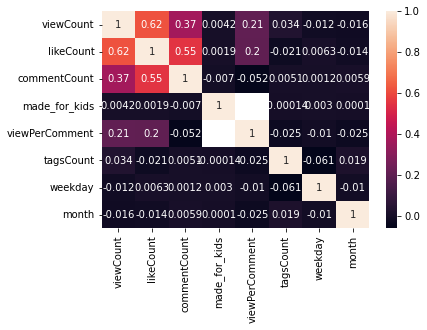

In [ ]:
sns.heatmap(df.corr(numeric_only=True), annot=True)
plt.show()

###  1-e. Converting `duration` into minutes representation

In duration, there is a value called "P0D" which stands for streaming. In order to better assess the data, let's remove any videos that are streaming.

In [ ]:
df = df[~(df['duration'] == 'P0D')]

In [ ]:
def convert_duration(duration_str):
    #Extract hours, minutes, and seconds using regex
    pattern = r'PT(?:(\d+)H)?(?:(\d+)M)?(?:(\d+)S)?'
    match = re.match(pattern, duration_str)
    if match:
        hours = int(match.group(1) or 0)
        minutes = int(match.group(2) or 0)
        seconds = int(match.group(3) or 0)
    else:
        raise ValueError("Invalid format")

    #Calculate duration in minutes
    total_min = hours*60 + minutes + seconds/60

    return total_min

In [ ]:
df['duration'] = df['duration'].apply(convert_duration)

df.head()

,title,channelName,description,tags,category,viewCount,likeCount,dislikeCount,commentCount,duration,postingDate,made_for_kids,viewPerComment,tagsCount,year,weekday,time,month,time_of_day
0,Garten of BanBan 3,Markiplier,Chapter 3 of Garten of BanBan is out! Where is...,"['garten of banban 3', 'markiplier', 'scary ga...",Gaming,419788,39271,private,2538,75.583333,2023-05-22 16:27:31+00:00,False,165.401103,8,2023,0,16:27,5,afternoon
1,The Return to Bloody Nights: Part 1,Markiplier,The Return to Bloody Nights is an amazing Five...,"['markiplier', 'the return to bloody nights', ...",Gaming,2420031,156694,private,6633,35.800000,2023-05-21 17:15:35+00:00,False,364.847128,6,2023,6,17:15,5,afternoon
2,Amanda the Adventurer: ALL ENDINGS,Markiplier,NEW CLOAK COLLECTION ► https://cloakbrand.com/...,"['markiplier', 'amanda the adventurer', 'scary...",Gaming,1718988,78836,private,2315,125.716667,2023-05-20 00:55:07+00:00,False,742.543413,3,2023,5,00:55,5,evening
3,BODY CAM HORROR GAME | DEPPART,Markiplier,This horror game has a deeper level of immersi...,"['markiplier', 'scary games', 'body cam horror...",Gaming,2068246,119458,private,5293,22.133333,2023-05-19 16:03:42+00:00,False,390.751181,9,2023,4,16:03,5,afternoon
4,Ronald McDonalds,Markiplier,Ronald McDonald is coming to give you the happ...,"['markiplier', 'scary games', 'ronald mcdonald...",Gaming,2049165,113299,private,4649,21.350000,2023-05-18 18:08:20+00:00,False,440.775436,9,2023,3,18:08,5,evening


# 2. EDA

## 2-a. Channel Analysis 

### Channel vs. View Count

PewDiePie channel has the highest view count, followed by MrBeast.

In [ ]:
df_Channel = df.groupby('channelName')["viewCount"].sum().reset_index()
df_comment = df.groupby('channelName')["commentCount"].sum().reset_index()

df_Channel["commentCount"] = df_comment.commentCount
df_Channel.sort_values(by=['viewCount'], ascending=False)

,channelName,viewCount,commentCount
13,Markiplier,19996249979,49538400
4,Dude Perfect,16025471756,9490037
18,NickyJamTV,15004978426,1967540
12,Linus Tech Tips,7004252566,16717565
9,Jordan Matter,5491012474,2921264
21,Sidemen,5097419613,4934132
23,Typical Gamer,4235688093,5041055
8,JJ Olatunji,4035206851,8978395
28,videogamedunkey,3710616931,4474827
14,Marques Brownlee,3463711443,8748891


In [ ]:
fig = px.histogram(df, x = "channelName",y = "viewCount",
             height=500,width=600)
fig.update_layout(xaxis = {"categoryorder":"total descending"},
                 title_text='Channel vs. View Count')
fig.show()

In [ ]:
fig = px.histogram(df, x = "channelName",y = "viewPerComment",
             height=500,width=600)
fig.update_layout(xaxis = {"categoryorder":"total descending"},
                 title_text='Channel vs. View Count')
fig.show()

The table below shows the mean view per comment of each channels.

In [ ]:
sum_viewCount= df.dropna(subset=['viewPerComment'])
sum_viewCount= sum_viewCount.groupby("channelName")[["viewPerComment"]].agg({'viewPerComment': lambda x: x.mean(skipna=True)})
sum_viewCount.sort_values(by=['viewPerComment'], ascending=False)

,viewPerComment
channelName,
Architectural Digest,inf
LDShadowLady,inf
videogamedunkey,inf
Yes Theory,inf
Typical Gamer,inf
Ryan Trahan,inf
Bionic,inf
Marques Brownlee,inf
Markiplier,inf


##  2-b. Time Analysis

Most viral videos are published in the evening, around 6pm.

In [ ]:
df['time'] = pd.to_datetime(df['time'])

fig = px.histogram(df, x = "time",
                   height=500,width=600,
                   title='Publish Time Distribution',
                   hover_data={"time": "|%H:%M"})
fig.update_xaxes(tickformat="|%H:%M")
fig.show()

C:\Users\user\AppData\Local\Temp\ipykernel_37752\547979314.py:1: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.



In [ ]:
fig = px.histogram(df, x = "time_of_day",
                   height=500,width=600,
                   title='Publish Time In A Day',
                   category_orders=dict(time_of_day=["morning", "afternoon", "evening"]))

fig.show()

### Tags Count vs. View Count and Comment Count

We do not see a significant pattern between view count and tags count. 

In [ ]:
fig = px.scatter(data_frame=df,
                y="viewCount",
                x="tagsCount",
                 color="channelName",
                 width=600,
                 height=600,
                 opacity= .5,
                 marginal_x="rug"
                )

fig.show()

The higher the view count generally has a higher comment count, but the relationships are not too noticeable either.

In [ ]:
fig = px.scatter(data_frame=df,
                y="viewCount",
                x="commentCount",
                 color="channelName",
                 width=600,
                 height=600,
                 opacity= .5,
                 marginal_x="rug"
                )

fig.show()

###  Month vs. LikeCount, ViewCount and CommentCount

There is no significant relationship between the publish month and view count. Similarly for comment count.

In [ ]:
fig=px.histogram(df,
                x="month",
                 y = "likeCount",
                width=500,
                 height=300,
                 nbins=30,
                 opacity=.5,
                 barmode="overlay")
fig.update_layout(margin={"r":0,"l":0,"b":0,"t":50})
fig.show()

In [ ]:
fig=px.histogram(df,
                x="month",
                 y = "viewCount",
                width=500,
                 height=300,
                 nbins=30,
                 opacity=.5,
                 barmode="overlay")
fig.update_layout(margin={"r":0,"l":0,"b":0,"t":50})
fig.show()

In [ ]:
fig=px.histogram(df,
                x="month",
                 y = "commentCount",
                width=500,
                 height=300,
                 nbins=30,
                 opacity=.5,
                 barmode="overlay")
fig.update_layout(margin={"r":0,"l":0,"b":0,"t":50})
fig.show()

### Average viewCount vs. Average commentCount for each channel in each month

In [ ]:
averages = df.groupby(["month", "channelName"])[["viewCount", "commentCount"]].mean()
averages=averages.reset_index()
averages.head()

,month,channelName,viewCount,commentCount
0,1,Architectural Digest,1.392434e+06,1076.268293
1,1,Bionic,2.087790e+06,4399.042254
2,1,Complex,8.753562e+05,1341.183168
3,1,Dangie Bros,3.227249e+06,2298.840000
4,1,Dude Perfect,6.272591e+07,29780.629630


In [ ]:
fig=px.histogram(averages,
                x="channelName",
                 y = "commentCount",
                width=600,
                 height=600,
                 nbins=30,
                 opacity=.5,
                 barmode="overlay",
                facet_col="month",
                facet_col_wrap=4,
                )

for axis in fig.select_yaxes():
    axis.title = None
    
fig.update_layout(
    yaxis_title="Sum of comment count",
)

fig.show()

In [ ]:
fig=px.histogram(averages,
                x="channelName",
                 y = "viewCount",
                width=600,
                 height=600,
                 nbins=30,
                 opacity=.5,
                 barmode="overlay",
                facet_col="month",
                facet_col_wrap=4,
                )

for axis in fig.select_yaxes():
    axis.title = None
    
fig.update_layout(
    yaxis_title="Sum of comment count"
)

fig.show()

##  2-c. Length of title Analysis

### Explore the impact of the length of title and # of tags with Like Count, viewCount and commentCount

[Text(0.5, 0, 'Likes'), Text(0, 0.5, 'Title Length')]

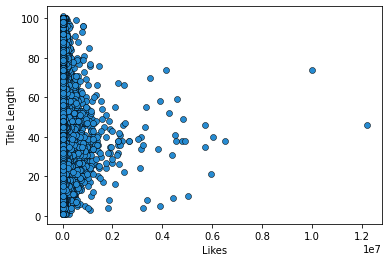

In [ ]:
df["title_length"] = df["title"].apply(lambda x: len(x))
fig, ax = plt.subplots()
ax.scatter(x=df['likeCount'], y=df['title_length'], color="#268bd2", edgecolors="#000000", linewidths=0.5)
#ax.set_xscale('log')  # log transform the x-axis
ax.set(xlabel="Likes", ylabel="Title Length")

[Text(0.5, 0, 'Comments'), Text(0, 0.5, 'Title Length')]

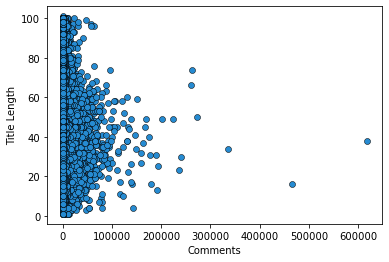

In [ ]:
df["title_length"] = df["title"].apply(lambda x: len(x))
fig, ax = plt.subplots()
ax.scatter(x=df['commentCount'], y=df['title_length'], color="#268bd2", edgecolors="#000000", linewidths=0.5)
#ax.set_xscale('log')  # log transform the x-axis
ax.set(xlabel="Comments", ylabel="Title Length")

[Text(0.5, 0, 'Views'), Text(0, 0.5, 'Tags Count')]

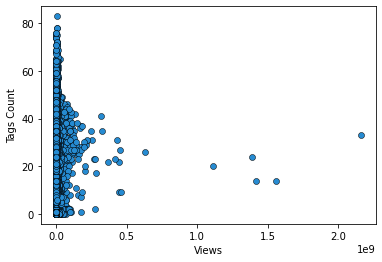

In [ ]:
fig, ax = plt.subplots()
ax.scatter(x=df['viewCount'], y=df['tagsCount'], color="#268bd2", edgecolors="#000000", linewidths=0.5)
#ax.set_xscale('log')  # log transform the x-axis
ax.set(xlabel="Views", ylabel="Tags Count")

## 2-d. Category Analysis

### View count, Like count and Comment count vs. Category

Gaming category generates the most videos while Entertainment category gets the most views.

In [ ]:
df.category.value_counts()

category
Gaming                   16816
Science & Technology      7626
Entertainment             5882
Comedy                    1983
Music                      804
Sports                     457
Howto & Style              450
People & Blogs             347
Travel & Events            132
Film & Animation            49
Pets & Animals              40
Autos & Vehicles            11
Education                   10
Nonprofits & Activism        8
News & Politics              6
Name: count, dtype: int64

In [ ]:
df_Views_Analysis = df.groupby('category')["viewCount"].sum().reset_index()
df_Views_Analysis.sort_values(by=['viewCount'], ascending=False)

,category,viewCount
5,Gaming,37852966153
3,Entertainment,22039093135
7,Music,17355932997
13,Sports,16005749213
12,Science & Technology,10419207128
1,Comedy,5745305592
6,Howto & Style,1482457809
10,People & Blogs,784138093
11,Pets & Animals,713880834
4,Film & Animation,354506841


In [ ]:
fig=px.histogram(df,
                x="category",
                y = "viewCount",
                width=600,
                 height=500,
                 nbins=30,
                 barmode="overlay",
                color="category")
fig.update_layout(xaxis = {"categoryorder":"total descending"},
                 title_text='Category vs. View Count')
fig.show()

Gaming category has the highest comment count, followed by Entertainment.

In [ ]:
fig=px.histogram(df,
                x="category",
                y = "commentCount",
                width=600,
                 height=500,
                 nbins=30,
                 barmode="overlay",
                color="category")
fig.update_layout(xaxis = {"categoryorder":"total descending"},
                 title_text='Category vs. Comment Count')
fig.show()

In [ ]:
df.head()

,title,channelName,description,tags,category,viewCount,likeCount,dislikeCount,commentCount,duration,postingDate,made_for_kids,viewPerComment,tagsCount,year,weekday,time,month,time_of_day,title_length
0,Garten of BanBan 3,Markiplier,Chapter 3 of Garten of BanBan is out! Where is...,"['garten of banban 3', 'markiplier', 'scary ga...",Gaming,419788,39271,private,2538,75.583333,2023-05-22 16:27:31+00:00,False,165.401103,8,2023,0,2023-05-23 16:27:00,5,afternoon,18
1,The Return to Bloody Nights: Part 1,Markiplier,The Return to Bloody Nights is an amazing Five...,"['markiplier', 'the return to bloody nights', ...",Gaming,2420031,156694,private,6633,35.800000,2023-05-21 17:15:35+00:00,False,364.847128,6,2023,6,2023-05-23 17:15:00,5,afternoon,35
2,Amanda the Adventurer: ALL ENDINGS,Markiplier,NEW CLOAK COLLECTION ► https://cloakbrand.com/...,"['markiplier', 'amanda the adventurer', 'scary...",Gaming,1718988,78836,private,2315,125.716667,2023-05-20 00:55:07+00:00,False,742.543413,3,2023,5,2023-05-23 00:55:00,5,evening,34
3,BODY CAM HORROR GAME | DEPPART,Markiplier,This horror game has a deeper level of immersi...,"['markiplier', 'scary games', 'body cam horror...",Gaming,2068246,119458,private,5293,22.133333,2023-05-19 16:03:42+00:00,False,390.751181,9,2023,4,2023-05-23 16:03:00,5,afternoon,30
4,Ronald McDonalds,Markiplier,Ronald McDonald is coming to give you the happ...,"['markiplier', 'scary games', 'ronald mcdonald...",Gaming,2049165,113299,private,4649,21.350000,2023-05-18 18:08:20+00:00,False,440.775436,9,2023,3,2023-05-23 18:08:00,5,evening,16


In [ ]:
fig=px.histogram(df,
                x="category",
                y = "likeCount",
                width=600,
                 height=500,
                 nbins=30,
                 barmode="overlay",
                color="category")
fig.update_layout(xaxis = {"categoryorder":"total descending"},
                 title_text='Category vs. Like Count')
fig.show()

###  Cateogry vs. Made_for_kids

Viral videos are barely made for kids.

In [ ]:
df_kids_Analysis = df.groupby('category')["made_for_kids"].sum().reset_index()
df_kids_Analysis.sort_values(by=['made_for_kids'], ascending=False)

,category,made_for_kids
3,Entertainment,4
5,Gaming,3
7,Music,2
1,Comedy,1
0,Autos & Vehicles,0
2,Education,0
4,Film & Animation,0
6,Howto & Style,0
8,News & Politics,0
9,Nonprofits & Activism,0


In [ ]:
fig = px.histogram(df, x="category", color="made_for_kids").update_xaxes(categoryorder='total descending')
fig.show()

### Cateogry vs. time published

Most categories does not prefer to publish videos in the morning except for travel & events. Sports, Science shows the highest rate of publishing videos in the evening. Education, on the other hand, tend to publish videos in the afternoon.

<AxesSubplot:xlabel='category'>

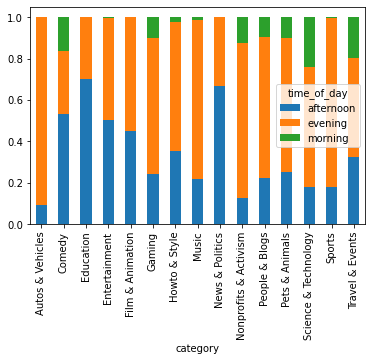

In [ ]:
(df.groupby('category')['time_of_day'].value_counts(normalize=True)
   .unstack('time_of_day').plot.bar(stacked=True)
)

Trends we observe from the graph below shows that Sports category tend to publish videos more on Tuesdays. Interestingly, Autos & Vehicles only publish videos on Thursday, Wednesday and Friday. 

In [ ]:
fig=px.histogram(df,
                x = "weekday",
                width=900,
                 height=600,
                 nbins=30,
                 opacity=.5,
                 barmode="overlay",
                facet_col="category",
                facet_col_wrap=4,
                 histnorm='percent',
                 color="category"
                )

fig.update_traces(showlegend=False)

fig.show()

# 3. Data Preprocessing


## 3-a. Create a response variable 


First we need to define our target variable, which is `viewCount`. Since we aim to perform classification task, we decided to split the `viewCount` variable into different sub group based on distribution of the data.


In [ ]:
df['viewCount'].describe()

count    3.462100e+04
mean     3.258829e+06
std      2.209591e+07
min      0.000000e+00
25%      2.021480e+05
50%      9.840660e+05
75%      2.824008e+06
max      2.159532e+09
Name: viewCount, dtype: float64

In [ ]:
fig = px.box(df, y="viewCount")
fig.show()

Since the data is extremely left skewed, we should look at outliers.


In [ ]:
#outliers
df1 = df.copy()
no_outliers = df1[df1['viewCount']<=10000000]

no_outliers

fig = px.box(no_outliers, y="viewCount")
fig.show()

We can categorize the view count into the following subcategories:
- Level 0: 0-10,000 view counts
- Level 1: 10,001-100,000
- Level 2: 100,001- 500,000
- Level 3: 500,001 - 1,000,000
- Level 4: 1,000,000 - 5,000,000
- Level 5: 5,000,001 - 10,000,000
- Level 6: 10,000,001 - 50,000,000
- Level 7: 50,000,001 - 100,000,000 (50M-100M)
- Level 8: 100,000,001 - 500,000,000
- Level 9: >500,000,000 (500M)

In [ ]:
# Define the bins and labels
bins = [-1, 10000, 100000, 500000, 1000000,5000000,10000000,50000000,100000000,500000000, float('inf')]
labels = ['0','1', '2', '3', '4','5','6','7','8','9']

# Convert numerical values into different categories
df['viewCount'] = pd.cut(df['viewCount'], bins=bins, labels=labels)


## 3-b. Create intervals for duration

We also need to change `duration` into cateogories for model implementation.

In [ ]:
fig = px.box(df, y="duration")
fig.show()

In [ ]:
df1 = df.copy()
no_outliers = df1[df1['duration']<=100]

no_outliers

fig = px.box(no_outliers, y="duration")
fig.show()

Let's put duration into the following categories:

- Level 0: Less than 5 min
- Level 1: Less than 10 min
- Level 2: Less than 30 min
- Level 3: Less than 60 min
- Level 4: Less than 2 hours
- Level 5: > 2 hours


In [ ]:
# Define the bins and labels
bins = [-1, 5,10,30,60,120, float('inf')]
labels = ['0', '1', '2', '3','4','5']

# Convert numerical values into different categories
df['duration'] = pd.cut(df['duration'], bins=bins, labels=labels)


## 3-c. Clean data: Remove unimportant columns, NA imputation etc.

We can remove `title`, `channelName`, `dislikeCount`, `postingDate` from our dataset.

In [ ]:
def replaceNullByZero(col):   
    """
    Replace NaN and infinity values by zeros
    """
    col_value = col[0]
    col_value = np.nan_to_num(col_value, nan=0, posinf=0, neginf=0)
    return col_value

In [ ]:
from sklearn import preprocessing

def preprocess(data_df): 
    df = data_df.copy()
    #Remove the Null Values in the Data
    df['commentCount']=df[['commentCount']].apply(replaceNullByZero,axis=1)
    df['likeCount']=df[['likeCount']].apply(replaceNullByZero,axis=1)
    df['viewPerComment']=df[['viewPerComment']].apply(replaceNullByZero,axis=1)
    df['duration']=df[['duration']].apply(replaceNullByZero,axis=1)
    
    #Formatting the Date
    #df['year']=pd.to_datetime(df['year'], format="%Y")

    #Formatting categorical variables
    label_encoder = preprocessing.LabelEncoder()
    df[['duration','category','viewCount', 'made_for_kids','weekday', 'time_of_day']] = df[['duration','category','viewCount', 
                                                                      'made_for_kids','weekday', 
                                                                      'time_of_day']].apply(lambda x: label_encoder.fit_transform(x))
    
    #drop unuseful columns
    df.drop(['title','channelName','dislikeCount', 
                  'postingDate','description','tags'],
                 axis=1,inplace = True)
    
    
    return df


In [ ]:
youtube=preprocess(df)
youtube.head()

,category,viewCount,likeCount,commentCount,duration,made_for_kids,viewPerComment,tagsCount,year,weekday,time,month,time_of_day,title_length
0,5,2,39271,2538,4,0,165.401103,8,2023,0,2023-05-23 16:27:00,5,0,18
1,5,4,156694,6633,3,0,364.847128,6,2023,6,2023-05-23 17:15:00,5,0,35
2,5,4,78836,2315,5,0,742.543413,3,2023,5,2023-05-23 00:55:00,5,1,34
3,5,4,119458,5293,2,0,390.751181,9,2023,4,2023-05-23 16:03:00,5,0,30
4,5,4,113299,4649,2,0,440.775436,9,2023,3,2023-05-23 18:08:00,5,1,16


In [ ]:
df.head()

,title,channelName,description,tags,category,viewCount,likeCount,dislikeCount,commentCount,duration,postingDate,made_for_kids,viewPerComment,tagsCount,year,weekday,time,month,time_of_day,title_length
0,Garten of BanBan 3,Markiplier,Chapter 3 of Garten of BanBan is out! Where is...,"['garten of banban 3', 'markiplier', 'scary ga...",Gaming,2,39271,private,2538,4,2023-05-22 16:27:31+00:00,False,165.401103,8,2023,0,2023-05-23 16:27:00,5,afternoon,18
1,The Return to Bloody Nights: Part 1,Markiplier,The Return to Bloody Nights is an amazing Five...,"['markiplier', 'the return to bloody nights', ...",Gaming,4,156694,private,6633,3,2023-05-21 17:15:35+00:00,False,364.847128,6,2023,6,2023-05-23 17:15:00,5,afternoon,35
2,Amanda the Adventurer: ALL ENDINGS,Markiplier,NEW CLOAK COLLECTION ► https://cloakbrand.com/...,"['markiplier', 'amanda the adventurer', 'scary...",Gaming,4,78836,private,2315,5,2023-05-20 00:55:07+00:00,False,742.543413,3,2023,5,2023-05-23 00:55:00,5,evening,34
3,BODY CAM HORROR GAME | DEPPART,Markiplier,This horror game has a deeper level of immersi...,"['markiplier', 'scary games', 'body cam horror...",Gaming,4,119458,private,5293,2,2023-05-19 16:03:42+00:00,False,390.751181,9,2023,4,2023-05-23 16:03:00,5,afternoon,30
4,Ronald McDonalds,Markiplier,Ronald McDonald is coming to give you the happ...,"['markiplier', 'scary games', 'ronald mcdonald...",Gaming,4,113299,private,4649,2,2023-05-18 18:08:20+00:00,False,440.775436,9,2023,3,2023-05-23 18:08:00,5,evening,16


In [ ]:
#double check
youtube.isnull().sum().sum()

0

In [ ]:
youtube.shape

(34621, 14)

In [ ]:
youtube.to_csv('cleaned_data.csv')

### Create Key tables

In [ ]:
#create key table for category

sorted_categories = sorted(df['category'].unique())

category_ids = {category: id for id, category in enumerate(sorted_categories)}

id_table = pd.DataFrame(df['category'].copy())

# Add the 'encoded id' column to the DataFrame
id_table['id'] = id_table['category'].map(category_ids)

unique_df = id_table.drop_duplicates(subset='category')
unique_df.sort_values('id')

,category,id
1081,Autos & Vehicles,0
197,Comedy,1
874,Education,2
217,Entertainment,3
235,Film & Animation,4
0,Gaming,5
970,Howto & Style,6
130,Music,7
1309,News & Politics,8
858,Nonprofits & Activism,9


In [ ]:
#create key table for time_of_day

sorted_categories = sorted(df['time_of_day'].unique())

category_ids = {category: id for id, category in enumerate(sorted_categories)}

id_table = pd.DataFrame(df['time_of_day'].copy())

# Add the 'encoded id' column to the DataFrame
id_table['id'] = id_table['time_of_day'].map(category_ids)

unique_df = id_table.drop_duplicates(subset='time_of_day')
unique_df.sort_values('id')

,time_of_day,id
0,afternoon,0
2,evening,1
313,morning,2
